# Installing & Importing Libraries

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install keract
import keract

In [3]:
import pickle
import numpy as np
import pandas as pd
from PIL import Image
import albumentations as A
from IPython.display import SVG
import matplotlib.pyplot as plt
%matplotlib inline
import os, re, sys, random, shutil, cv2

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam, Nadam
from tensorflow.keras import applications, optimizers
from tensorflow.keras.applications.resnet50 import preprocess_input

from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.utils import model_to_dot, plot_model
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, CSVLogger, LearningRateScheduler
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, ZeroPadding2D, Dropout

# Working with Augmented Dataset

In [4]:
# train_images = "../input/augmented-dubai-aerial-imagery-dataset/train_images/"
# train_masks = "../input/augmented-dubai-aerial-imagery-dataset/train_masks/"
# val_images = "../input/augmented-dubai-aerial-imagery-dataset/val_images/"
# val_masks = "../input/augmented-dubai-aerial-imagery-dataset/val_masks/"
train_images = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/train_images/"
train_masks = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/train_masks/"
val_images = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/val_images/"
val_masks = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/val_masks/"

In [5]:
file_names = np.sort(os.listdir(train_images + 'train/'))
file_names = np.char.split(file_names, '.')
filenames = np.array([])
for i in range(len(file_names)):
    filenames = np.append(filenames, file_names[i][0])

In [6]:
# def show_data(files, original_images_dir, label_images_dir):

#     for file in files:
#         fig, axs = plt.subplots(1, 2, figsize=(15, 6), constrained_layout=True)

#         axs[0].imshow(cv2.resize(cv2.imread(original_images_dir+'train/'+str(file)+'.jpg'), (2000,1400)))
#         axs[0].set_title('Original Image', fontdict = {'fontsize':14, 'fontweight': 'medium'})
#         axs[0].set_xticks(np.arange(0, 2001, 200))
#         axs[0].set_yticks(np.arange(0, 1401, 200))
#         axs[0].grid(False)
#         axs[0].axis(True)

#         semantic_label_image = cv2.imread(label_images_dir+ 'train/'+str(file)+'.png')
#         semantic_label_image = cv2.cvtColor(semantic_label_image, cv2.COLOR_BGR2RGB)
#         semantic_label_image = cv2.resize(semantic_label_image, (2000,1400))
#         axs[1].imshow(semantic_label_image)
#         axs[1].set_title('Semantic Segmentation Mask', fontdict = {'fontsize':14, 'fontweight': 'medium'})
#         axs[1].set_xticks(np.arange(0, 2001, 200))
#         axs[1].set_yticks(np.arange(0, 1401, 200))
#         axs[1].grid(False)
#         axs[1].axis(True)

#         plt.savefig('./sample_'+file, facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 100)
#         plt.show()


# files = ['image_t4_003', 'image_t4_005', 'image_t6_002', 'image_t7_002', 'image_t8_003', 'image_t8_004', 'image_t8_006']
# show_data(files, train_images, train_masks)

In [7]:
import numpy as np
import pandas as pd

# Define class colors
class_building = '#3C1098'
class_building = class_building.lstrip('#')
class_building = np.array(tuple(int(class_building[i:i+2], 16) for i in (0,2,4)))

class_land = '#8429F6'
class_land = class_land.lstrip('#')
class_land = np.array(tuple(int(class_land[i:i+2], 16) for i in (0,2,4)))

class_road = '#6EC1E4'
class_road = class_road.lstrip('#')
class_road = np.array(tuple(int(class_road[i:i+2], 16) for i in (0,2,4)))

class_vegetation = '#FEDD3A'
class_vegetation = class_vegetation.lstrip('#')
class_vegetation = np.array(tuple(int(class_vegetation[i:i+2], 16) for i in (0,2,4)))

class_water = '#E2A929'
class_water = class_water.lstrip('#')
class_water = np.array(tuple(int(class_water[i:i+2], 16) for i in (0,2,4)))

class_unlabeled = '#9B9B9B'
class_unlabeled = class_unlabeled.lstrip('#')
class_unlabeled = np.array(tuple(int(class_unlabeled[i:i+2], 16) for i in (0,2,4)))

# Create DataFrame
data = {
    'name': ['building', 'land', 'road', 'vegetation', 'water', 'unlabeled'],
    'r': [class_building[0], class_land[0], class_road[0], class_vegetation[0], class_water[0], class_unlabeled[0]],
    'g': [class_building[1], class_land[1], class_road[1], class_vegetation[1], class_water[1], class_unlabeled[1]],
    'b': [class_building[2], class_land[2], class_road[2], class_vegetation[2], class_water[2], class_unlabeled[2]]
}

df = pd.DataFrame(data)

# Save DataFrame to CSV
df.to_csv('class_colors.csv', index=False)


In [8]:
class_dict_df = pd.read_csv('/content/class_colors.csv', index_col=False, skipinitialspace=True)
class_dict_df

,name,r,g,b
0,building,60,16,152
1,land,132,41,246
2,road,110,193,228
3,vegetation,254,221,58
4,water,226,169,41
5,unlabeled,155,155,155


In [9]:
label_names= list(class_dict_df.name)
label_codes = []
r= np.asarray(class_dict_df.r)
g= np.asarray(class_dict_df.g)
b= np.asarray(class_dict_df.b)

for i in range(len(class_dict_df)):
    label_codes.append(tuple([r[i], g[i], b[i]]))

label_codes, label_names

([(60, 16, 152),
  (132, 41, 246),
  (110, 193, 228),
  (254, 221, 58),
  (226, 169, 41),
  (155, 155, 155)],
 ['building', 'land', 'road', 'vegetation', 'water', 'unlabeled'])

# Create Useful Label & Code Conversion Dictionaries

These will be used for:

* One hot encoding the mask labels for model training
* Decoding the predicted labels for interpretation and visualization

In [10]:
code2id = {v:k for k,v in enumerate(label_codes)}
id2code = {k:v for k,v in enumerate(label_codes)}

name2id = {v:k for k,v in enumerate(label_names)}
id2name = {k:v for k,v in enumerate(label_names)}

In [11]:
id2code

{0: (60, 16, 152),
 1: (132, 41, 246),
 2: (110, 193, 228),
 3: (254, 221, 58),
 4: (226, 169, 41),
 5: (155, 155, 155)}

In [12]:
id2name

{0: 'building',
 1: 'land',
 2: 'road',
 3: 'vegetation',
 4: 'water',
 5: 'unlabeled'}

# Define Functions for One Hot Encoding RGB Labels & Decoding Encoded Predictions

In [13]:
def rgb_to_onehot(rgb_image, colormap = id2code):
    '''Function to one hot encode RGB mask labels
        Inputs:
            rgb_image - image matrix (eg. 256 x 256 x 3 dimension numpy ndarray)
            colormap - dictionary of color to label id
        Output: One hot encoded image of dimensions (height x width x num_classes) where num_classes = len(colormap)
    '''
    num_classes = len(colormap)
    shape = rgb_image.shape[:2]+(num_classes,)
    encoded_image = np.zeros( shape, dtype=np.int8 )
    for i, cls in enumerate(colormap):
        encoded_image[:,:,i] = np.all(rgb_image.reshape( (-1,3) ) == colormap[i], axis=1).reshape(shape[:2])
    return encoded_image


def onehot_to_rgb(onehot, colormap = id2code):
    '''Function to decode encoded mask labels
        Inputs:
            onehot - one hot encoded image matrix (height x width x num_classes)
            colormap - dictionary of color to label id
        Output: Decoded RGB image (height x width x 3)
    '''
    single_layer = np.argmax(onehot, axis=-1)
    output = np.zeros( onehot.shape[:2]+(3,) )
    for k in colormap.keys():
        output[single_layer==k] = colormap[k]
    return np.uint8(output)

# Creating Custom Image Data Generators
## Defining Data Generators

In [14]:
# Normalizing only frame images, since masks contain label info
data_gen_args = dict(rescale=1./255)
mask_gen_args = dict()

train_frames_datagen = ImageDataGenerator(**data_gen_args)
train_masks_datagen = ImageDataGenerator(**mask_gen_args)
val_frames_datagen = ImageDataGenerator(**data_gen_args)
val_masks_datagen = ImageDataGenerator(**mask_gen_args)

# Seed defined for aligning images and their masks
seed = 1

# Custom Image Data Generators for Creating Batches of Frames and Masks

In [15]:
def TrainAugmentGenerator(train_images_dir, train_masks_dir, seed=1, batch_size=8, target_size=(512, 512)):
    train_image_generator = train_frames_datagen.flow_from_directory(
        train_images_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    train_mask_generator = train_masks_datagen.flow_from_directory(
        train_masks_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    while True:
        X1i = train_image_generator.next()
        X2i = train_mask_generator.next()

        # One hot encoding RGB images
        mask_encoded = [rgb_to_onehot(X2i[0][x, :, :, :], id2code) for x in range(X2i[0].shape[0])]

        yield X1i[0], np.asarray(mask_encoded)


def ValAugmentGenerator(val_images_dir, val_masks_dir, seed=1, batch_size=8, target_size=(512, 512)):
    val_image_generator = val_frames_datagen.flow_from_directory(
        val_images_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    val_mask_generator = val_masks_datagen.flow_from_directory(
        val_masks_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    while True:
        X1i = val_image_generator.next()
        X2i = val_mask_generator.next()

        # One hot encoding RGB images
        mask_encoded = [rgb_to_onehot(X2i[0][x, :, :, :], id2code) for x in range(X2i[0].shape[0])]

        yield X1i[0], np.asarray(mask_encoded)


In [16]:
# def TrainAugmentGenerator(train_images_dir, train_masks_dir, seed = 1, batch_size = 8, target_size = (512, 512)):
#     '''Train Image data generator
#         Inputs:
#             seed - seed provided to the flow_from_directory function to ensure aligned data flow
#             batch_size - number of images to import at a time
#             train_images_dir - train images directory
#             train_masks_dir - train masks directory
#             target_size - tuple of integers (height, width)

#         Output: Decoded RGB image (height x width x 3)
#     '''
#     train_image_generator = train_frames_datagen.flow_from_directory(
#     train_images_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)

#     train_mask_generator = train_masks_datagen.flow_from_directory(
#     train_masks_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)

#     while True:
#         X1i = train_image_generator.next()
#         X2i = train_mask_generator.next()

#         #One hot encoding RGB images
#         mask_encoded = [rgb_to_onehot(X2i[0][x,:,:,:], id2code) for x in range(X2i[0].shape[0])]

#         yield X1i[0], np.asarray(mask_encoded)

# def ValAugmentGenerator(val_images_dir, val_masks_dir, seed = 1, batch_size = 8, target_size = (512, 512)):
#     '''Validation Image data generator
#         Inputs:
#             seed - seed provided to the flow_from_directory function to ensure aligned data flow
#             batch_size - number of images to import at a time
#             val_images_dir - validation images directory
#             val_masks_dir - validation masks directory
#             target_size - tuple of integers (height, width)

#         Output: Decoded RGB image (height x width x 3)
#     '''
#     val_image_generator = val_frames_datagen.flow_from_directory(
#     val_images_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)


#     val_mask_generator = val_masks_datagen.flow_from_directory(
#     val_masks_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)


#     while True:
#         X1i = val_image_generator.next()
#         X2i = val_mask_generator.next()

#         #One hot encoding RGB images
#         mask_encoded = [rgb_to_onehot(X2i[0][x,:,:,:], id2code) for x in range(X2i[0].shape[0])]

#         yield X1i[0], np.asarray(mask_encoded)

# Model

In [17]:
batch_size = 16
num_train_samples = len(np.sort(os.listdir(train_images+'train')))
num_val_samples = len(np.sort(os.listdir(val_images+'val')))
steps_per_epoch = np.ceil(float(num_train_samples) / float(batch_size))
print('steps_per_epoch: ', steps_per_epoch)
validation_steps = np.ceil(float(4 * num_val_samples) / float(batch_size))
print('validation_steps: ', validation_steps)

steps_per_epoch:  35.0
validation_steps:  18.0


## VGG19

In [18]:
import numpy as np
import os
import cv2
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPooling2D, UpSampling2D, Concatenate, Dropout


# Define the model architecture
def build_vgg19_like_model(input_shape):
    inputs = Input(shape=input_shape)

    # Encoder
    conv1_1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    conv1_2 = Conv2D(64, 3, activation='relu', padding='same')(conv1_1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1_2)

    conv2_1 = Conv2D(128, 3, activation='relu', padding='same')(pool1)
    conv2_2 = Conv2D(128, 3, activation='relu', padding='same')(conv2_1)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2_2)

    conv3_1 = Conv2D(256, 3, activation='relu', padding='same')(pool2)
    conv3_2 = Conv2D(256, 3, activation='relu', padding='same')(conv3_1)
    conv3_3 = Conv2D(256, 3, activation='relu', padding='same')(conv3_2)
    conv3_4 = Conv2D(256, 3, activation='relu', padding='same')(conv3_3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3_4)

    conv4_1 = Conv2D(512, 3, activation='relu', padding='same')(pool3)
    conv4_2 = Conv2D(512, 3, activation='relu', padding='same')(conv4_1)
    conv4_3 = Conv2D(512, 3, activation='relu', padding='same')(conv4_2)
    conv4_4 = Conv2D(512, 3, activation='relu', padding='same')(conv4_3)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4_4)

    conv5_1 = Conv2D(512, 3, activation='relu', padding='same')(pool4)
    conv5_2 = Conv2D(512, 3, activation='relu', padding='same')(conv5_1)
    conv5_3 = Conv2D(512, 3, activation='relu', padding='same')(conv5_2)
    conv5_4 = Conv2D(512, 3, activation='relu', padding='same')(conv5_3)
    pool5 = MaxPooling2D(pool_size=(2, 2))(conv5_4)

    # Decoder
    up6 = UpSampling2D(size=(2, 2))(pool5)
    merge6 = Concatenate()([conv5_4, up6])
    conv6_1 = Conv2D(512, 3, activation='relu', padding='same')(merge6)
    conv6_2 = Conv2D(512, 3, activation='relu', padding='same')(conv6_1)
    conv6_3 = Conv2D(512, 3, activation='relu', padding='same')(conv6_2)
    conv6_4 = Conv2D(512, 3, activation='relu', padding='same')(conv6_3)

    up7 = UpSampling2D(size=(2, 2))(conv6_4)
    merge7 = Concatenate()([conv4_4, up7])
    conv7_1 = Conv2D(512, 3, activation='relu', padding='same')(merge7)
    conv7_2 = Conv2D(512, 3, activation='relu', padding='same')(conv7_1)
    conv7_3 = Conv2D(512, 3, activation='relu', padding='same')(conv7_2)
    conv7_4 = Conv2D(512, 3, activation='relu', padding='same')(conv7_3)

    up8 = UpSampling2D(size=(2, 2))(conv7_4)
    merge8 = Concatenate()([conv3_4, up8])
    conv8_1 = Conv2D(256, 3, activation='relu', padding='same')(merge8)
    conv8_2 = Conv2D(256, 3, activation='relu', padding='same')(conv8_1)
    conv8_3 = Conv2D(256, 3, activation='relu', padding='same')(conv8_2)
    conv8_4 = Conv2D(256, 3, activation='relu', padding='same')(conv8_3)

    up9 = UpSampling2D(size=(2, 2))(conv8_4)
    merge9 = Concatenate()([conv2_2, up9])
    conv9_1 = Conv2D(128, 3, activation='relu', padding='same')(merge9)
    conv9_2 = Conv2D(128, 3, activation='relu', padding='same')(conv9_1)

    up10 = UpSampling2D(size=(2, 2))(conv9_2)
    merge10 = Concatenate()([conv1_2, up10])
    conv10_1 = Conv2D(64, 3, activation='relu', padding='same')(merge10)
    conv10_2 = Conv2D(64, 3, activation='relu', padding='same')(conv10_1)

    # Output layer
    outputs = Conv2D(6, 1, activation='softmax')(conv10_2)

    model = Model(inputs=inputs, outputs=outputs, name='VGG19_Like_Model')
    return model


In [19]:
K.clear_session()

def dice_coef(y_true, y_pred):
    return (2. * K.sum(y_true * y_pred) + 1.) / (K.sum(y_true) + K.sum(y_pred) + 1.)

model = build_vgg19_like_model(input_shape=(512, 512, 3))
model.compile(optimizer=Adam(lr = 0.0001), loss='categorical_crossentropy', metrics=[dice_coef, "accuracy"])
model.summary()

Model: "VGG19_Like_Model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 512, 512, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 conv2d_1 (Conv2D)           (None, 512, 512, 64)         36928     ['conv2d[0][0]']              
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 256, 256, 64)         0         ['conv2d_1[0][0]']            
 D)                                                                                

### Model Layout

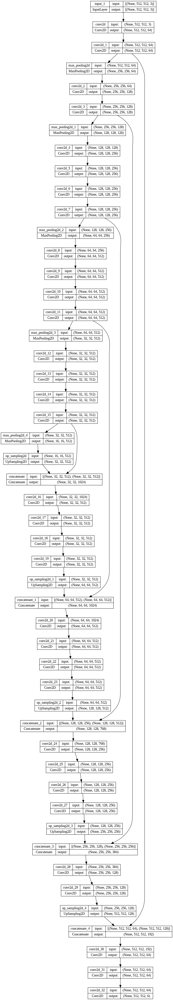

In [20]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True, expand_nested=True)

# Model Training

In [21]:
import numpy as np
import tensorflow as tf
from sklearn.metrics import precision_score, recall_score, f1_score

class MetricsCallback(tf.keras.callbacks.Callback):
    def __init__(self, validation_data):
        super(MetricsCallback, self).__init__()
        self.validation_data = validation_data

    def on_epoch_end(self, epoch, logs=None):
        val_preds = self.model.predict(self.validation_data[0])
        val_true = self.validation_data[1]

        val_preds_argmax = np.argmax(val_preds, axis=-1)
        val_true_argmax = np.argmax(val_true, axis=-1)

        val_recall = recall_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')
        val_precision = precision_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')
        val_f1 = f1_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')

        print(f' - val_recall: {val_recall:.4f} - val_precision: {val_precision:.4f} - val_f1: {val_f1:.4f}')

In [22]:
val_data = next(ValAugmentGenerator(val_images_dir=val_images, val_masks_dir=val_masks, target_size=(512, 512)))

# Instantiate the MetricsCallback
metrics_callback = MetricsCallback(validation_data=val_data)

Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.


In [23]:
def exponential_decay(lr0, s):
    def exponential_decay_fn(epoch):
        return lr0 * 0.1 **(epoch / s)
    return exponential_decay_fn

exponential_decay_fn = exponential_decay(0.0001, 60)

lr_scheduler = LearningRateScheduler(
    exponential_decay_fn,
    verbose=1
)

checkpoint = ModelCheckpoint(
    filepath = 'simple_VGG19.h5',
    save_best_only = True,
#     save_weights_only = False,
    monitor = 'val_loss',
    mode = 'auto',
    verbose = 1
)

earlystop = EarlyStopping(
    monitor = 'val_loss',
    min_delta = 0.001,
    patience = 12,
    mode = 'auto',
    verbose = 1,
    restore_best_weights = True
)

csvlogger = CSVLogger(
    filename= "model_training.csv",
    separator = ",",
    append = False
)

callbacks = [checkpoint, earlystop, csvlogger, lr_scheduler, metrics_callback]

In [24]:
history = model.fit(
    TrainAugmentGenerator(train_images_dir = train_images, train_masks_dir = train_masks, target_size = (512, 512)),
    steps_per_epoch=steps_per_epoch,
    validation_data = ValAugmentGenerator(val_images_dir = val_images, val_masks_dir = val_masks, target_size = (512, 512)),
    validation_steps = validation_steps,
    epochs = 50,
    callbacks=callbacks,
    use_multiprocessing=False,
    verbose=1
)

Found 548 images belonging to 1 classes.
Found 548 images belonging to 1 classes.

Epoch 1: LearningRateScheduler setting learning rate to 0.0001.
Epoch 1/50
35/35 [==============================] - ETA: 0s - loss: 1.4364 - dice_coef: 0.3167 - accuracy: 0.4781Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.

Epoch 1: val_loss improved from inf to 1.37308, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 341ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.1667 - val_precision: 0.2104 - val_f1: 0.0693
35/35 [==============================] - 398s 9s/step - loss: 1.4364 - dice_coef: 0.3167 - accuracy: 0.4781 - val_loss: 1.3731 - val_dice_coef: 0.3683 - val_accuracy: 0.4539 - lr: 1.0000e-04

Epoch 2: LearningRateScheduler setting learning rate to 9.623506263980886e-05.
Epoch 2/50
35/35 [==============================] - ETA: 0s - loss: 1.2884 - dice_coef: 0.3858 - accuracy: 0.5214
Epoch 2: val_loss improved from 1.37308 to 1.32392, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 46ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.1915 - val_precision: 0.2112 - val_f1: 0.1151
35/35 [==============================] - 275s 8s/step - loss: 1.2884 - dice_coef: 0.3858 - accuracy: 0.5214 - val_loss: 1.3239 - val_dice_coef: 0.3580 - val_accuracy: 0.4949 - lr: 9.6235e-05

Epoch 3: LearningRateScheduler setting learning rate to 9.261187281287936e-05.
Epoch 3/50
35/35 [==============================] - ETA: 0s - loss: 1.2145 - dice_coef: 0.4112 - accuracy: 0.5562
Epoch 3: val_loss improved from 1.32392 to 1.12283, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 47ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3035 - val_precision: 0.1764 - val_f1: 0.2196
35/35 [==============================] - 105s 3s/step - loss: 1.2145 - dice_coef: 0.4112 - accuracy: 0.5562 - val_loss: 1.1228 - val_dice_coef: 0.4368 - val_accuracy: 0.6119 - lr: 9.2612e-05

Epoch 4: LearningRateScheduler setting learning rate to 8.912509381337456e-05.
Epoch 4/50
35/35 [==============================] - ETA: 0s - loss: 1.0961 - dice_coef: 0.4734 - accuracy: 0.6047
Epoch 4: val_loss improved from 1.12283 to 1.10146, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 36ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3042 - val_precision: 0.2929 - val_f1: 0.2228
35/35 [==============================] - 103s 3s/step - loss: 1.0961 - dice_coef: 0.4734 - accuracy: 0.6047 - val_loss: 1.1015 - val_dice_coef: 0.4322 - val_accuracy: 0.6390 - lr: 8.9125e-05

Epoch 5: LearningRateScheduler setting learning rate to 8.576958985908941e-05.
Epoch 5/50
35/35 [==============================] - ETA: 0s - loss: 1.0851 - dice_coef: 0.4761 - accuracy: 0.6091
Epoch 5: val_loss improved from 1.10146 to 1.07569, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 40ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3069 - val_precision: 0.2725 - val_f1: 0.2228
35/35 [==============================] - 104s 3s/step - loss: 1.0851 - dice_coef: 0.4761 - accuracy: 0.6091 - val_loss: 1.0757 - val_dice_coef: 0.4588 - val_accuracy: 0.6360 - lr: 8.5770e-05

Epoch 6: LearningRateScheduler setting learning rate to 8.254041852680184e-05.
Epoch 6/50
35/35 [==============================] - ETA: 0s - loss: 1.1001 - dice_coef: 0.4688 - accuracy: 0.6043
Epoch 6: val_loss improved from 1.07569 to 0.93816, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 38ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3067 - val_precision: 0.2900 - val_f1: 0.2254
35/35 [==============================] - 106s 3s/step - loss: 1.1001 - dice_coef: 0.4688 - accuracy: 0.6043 - val_loss: 0.9382 - val_dice_coef: 0.5202 - val_accuracy: 0.6542 - lr: 8.2540e-05

Epoch 7: LearningRateScheduler setting learning rate to 7.943282347242815e-05.
Epoch 7/50
35/35 [==============================] - ETA: 0s - loss: 1.0158 - dice_coef: 0.4973 - accuracy: 0.6205
Epoch 7: val_loss did not improve from 0.93816
1/1 [==============================] - 0s 47ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3245 - val_precision: 0.3913 - val_f1: 0.2657
35/35 [==============================] - 103s 3s/step - loss: 1.0158 - dice_coef: 0.4973 - accuracy: 0.6205 - val_loss: 1.0197 - val_dice_coef: 0.5144 - val_accuracy: 0.6333 - lr: 7.9433e-05

Epoch 8: LearningRateScheduler setting learning rate to 7.644222742526003e-05.
Epoch 8/50
35/35 [==============================] - ETA: 0s - loss: 0.9798 - dice_coef: 0.5214 - accuracy: 0.6485
Epoch 8: val_loss improved from 0.93816 to 0.91882, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4001 - val_precision: 0.3677 - val_f1: 0.3433
35/35 [==============================] - 111s 3s/step - loss: 0.9798 - dice_coef: 0.5214 - accuracy: 0.6485 - val_loss: 0.9188 - val_dice_coef: 0.4993 - val_accuracy: 0.7044 - lr: 7.6442e-05

Epoch 9: LearningRateScheduler setting learning rate to 7.356422544596415e-05.
Epoch 9/50
35/35 [==============================] - ETA: 0s - loss: 0.9191 - dice_coef: 0.5447 - accuracy: 0.6732
Epoch 9: val_loss improved from 0.91882 to 0.79598, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4417 - val_precision: 0.4803 - val_f1: 0.3915
35/35 [==============================] - 104s 3s/step - loss: 0.9191 - dice_coef: 0.5447 - accuracy: 0.6732 - val_loss: 0.7960 - val_dice_coef: 0.5820 - val_accuracy: 0.7201 - lr: 7.3564e-05

Epoch 10: LearningRateScheduler setting learning rate to 7.07945784384138e-05.
Epoch 10/50
35/35 [==============================] - ETA: 0s - loss: 0.8868 - dice_coef: 0.5578 - accuracy: 0.6765
Epoch 10: val_loss did not improve from 0.79598
1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4338 - val_precision: 0.4033 - val_f1: 0.4040
35/35 [==============================] - 105s 3s/step - loss: 0.8868 - dice_coef: 0.5578 - accuracy: 0.6765 - val_loss: 0.8185 - val_dice_coef: 0.6223 - val_accuracy: 0.7147 - lr: 7.0795e-05

Epoch 11: LearningRateScheduler setting learning rate to 6.812920690579614e-05.
Epoch 11/50
35/35 [==============================] - ETA: 0s - loss: 0.9100 - dice_coef: 0.5537 - accuracy: 0.6641
Epoch 11: val_loss did not improve from 0.79598
1/1 [==============================] - 0s 30ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4533 - val_precision: 0.4578 - val_f1: 0.4137
35/35 [==============================] - 105s 3s/step - loss: 0.9100 - dice_coef: 0.5537 - accuracy: 0.6641 - val_loss: 0.8108 - val_dice_coef: 0.5699 - val_accuracy: 0.7064 - lr: 6.8129e-05

Epoch 12: LearningRateScheduler setting learning rate to 6.556418494179789e-05.
Epoch 12/50
35/35 [==============================] - ETA: 0s - loss: 0.8857 - dice_coef: 0.5629 - accuracy: 0.6771
Epoch 12: val_loss did not improve from 0.79598
1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4498 - val_precision: 0.4478 - val_f1: 0.4105
35/35 [==============================] - 105s 3s/step - loss: 0.8857 - dice_coef: 0.5629 - accuracy: 0.6771 - val_loss: 0.8184 - val_dice_coef: 0.5874 - val_accuracy: 0.6979 - lr: 6.5564e-05

Epoch 13: LearningRateScheduler setting learning rate to 6.309573444801933e-05.
Epoch 13/50
35/35 [==============================] - ETA: 0s - loss: 0.8724 - dice_coef: 0.5695 - accuracy: 0.6801
Epoch 13: val_loss improved from 0.79598 to 0.75233, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4835 - val_precision: 0.4480 - val_f1: 0.4530
35/35 [==============================] - 107s 3s/step - loss: 0.8724 - dice_coef: 0.5695 - accuracy: 0.6801 - val_loss: 0.7523 - val_dice_coef: 0.5970 - val_accuracy: 0.7366 - lr: 6.3096e-05

Epoch 14: LearningRateScheduler setting learning rate to 6.072021956909886e-05.
Epoch 14/50
35/35 [==============================] - ETA: 0s - loss: 0.8542 - dice_coef: 0.5752 - accuracy: 0.6869
Epoch 14: val_loss did not improve from 0.75233
1/1 [==============================] - 0s 30ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4367 - val_precision: 0.4475 - val_f1: 0.4070
35/35 [==============================] - 105s 3s/step - loss: 0.8542 - dice_coef: 0.5752 - accuracy: 0.6869 - val_loss: 0.8076 - val_dice_coef: 0.6193 - val_accuracy: 0.7165 - lr: 6.0720e-05

Epoch 15: LearningRateScheduler setting learning rate to 5.8434141337351765e-05.
Epoch 15/50
35/35 [==============================] - ETA: 0s - loss: 0.8134 - dice_coef: 0.5953 - accuracy: 0.7042
Epoch 15: val_loss did not improve from 0.75233
1/1 [==============================] - 0s 35ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4837 - val_precision: 0.5106 - val_f1: 0.4609
35/35 [==============================] - 106s 3s/step - loss: 0.8134 - dice_coef: 0.5953 - accuracy: 0.7042 - val_loss: 0.7751 - val_dice_coef: 0.6155 - val_accuracy: 0.7344 - lr: 5.8434e-05

Epoch 16: LearningRateScheduler setting learning rate to 5.623413251903491e-05.
Epoch 16/50
35/35 [==============================] - ETA: 0s - loss: 0.8952 - dice_coef: 0.5516 - accuracy: 0.6655
Epoch 16: val_loss improved from 0.75233 to 0.74058, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 51ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4818 - val_precision: 0.4818 - val_f1: 0.4519
35/35 [==============================] - 106s 3s/step - loss: 0.8952 - dice_coef: 0.5516 - accuracy: 0.6655 - val_loss: 0.7406 - val_dice_coef: 0.6145 - val_accuracy: 0.7321 - lr: 5.6234e-05

Epoch 17: LearningRateScheduler setting learning rate to 5.4116952654646367e-05.
Epoch 17/50
35/35 [==============================] - ETA: 0s - loss: 0.8726 - dice_coef: 0.5668 - accuracy: 0.6747
Epoch 17: val_loss did not improve from 0.74058
1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5010 - val_precision: 0.4923 - val_f1: 0.4765
35/35 [==============================] - 105s 3s/step - loss: 0.8726 - dice_coef: 0.5668 - accuracy: 0.6747 - val_loss: 0.7801 - val_dice_coef: 0.5737 - val_accuracy: 0.7411 - lr: 5.4117e-05

Epoch 18: LearningRateScheduler setting learning rate to 5.2079483285954645e-05.
Epoch 18/50
35/35 [==============================] - ETA: 0s - loss: 0.8240 - dice_coef: 0.5917 - accuracy: 0.6974
Epoch 18: val_loss improved from 0.74058 to 0.72144, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4600 - val_precision: 0.4854 - val_f1: 0.4258
35/35 [==============================] - 107s 3s/step - loss: 0.8240 - dice_coef: 0.5917 - accuracy: 0.6974 - val_loss: 0.7214 - val_dice_coef: 0.6241 - val_accuracy: 0.7461 - lr: 5.2079e-05

Epoch 19: LearningRateScheduler setting learning rate to 5.011872336272724e-05.
Epoch 19/50
35/35 [==============================] - ETA: 0s - loss: 0.8025 - dice_coef: 0.5968 - accuracy: 0.7004
Epoch 19: val_loss improved from 0.72144 to 0.71584, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 52ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4932 - val_precision: 0.5016 - val_f1: 0.4827
35/35 [==============================] - 108s 3s/step - loss: 0.8025 - dice_coef: 0.5968 - accuracy: 0.7004 - val_loss: 0.7158 - val_dice_coef: 0.6393 - val_accuracy: 0.7489 - lr: 5.0119e-05

Epoch 20: LearningRateScheduler setting learning rate to 4.8231784822393075e-05.
Epoch 20/50
35/35 [==============================] - ETA: 0s - loss: 0.8722 - dice_coef: 0.5664 - accuracy: 0.6746
Epoch 20: val_loss did not improve from 0.71584
1/1 [==============================] - 0s 56ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5052 - val_precision: 0.4937 - val_f1: 0.4809
35/35 [==============================] - 101s 3s/step - loss: 0.8722 - dice_coef: 0.5664 - accuracy: 0.6746 - val_loss: 0.7401 - val_dice_coef: 0.6113 - val_accuracy: 0.7368 - lr: 4.8232e-05

Epoch 21: LearningRateScheduler setting learning rate to 4.641588833612779e-05.
Epoch 21/50
35/35 [==============================] - ETA: 0s - loss: 0.8327 - dice_coef: 0.5809 - accuracy: 0.6944
Epoch 21: val_loss did not improve from 0.71584
1/1 [==============================] - 0s 30ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4991 - val_precision: 0.4962 - val_f1: 0.4729
35/35 [==============================] - 107s 3s/step - loss: 0.8327 - dice_coef: 0.5809 - accuracy: 0.6944 - val_loss: 0.7342 - val_dice_coef: 0.6262 - val_accuracy: 0.7339 - lr: 4.6416e-05

Epoch 22: LearningRateScheduler setting learning rate to 4.4668359215096314e-05.
Epoch 22/50
35/35 [==============================] - ETA: 0s - loss: 0.8136 - dice_coef: 0.5923 - accuracy: 0.6947
Epoch 22: val_loss did not improve from 0.71584
1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5109 - val_precision: 0.5207 - val_f1: 0.5083
35/35 [==============================] - 105s 3s/step - loss: 0.8136 - dice_coef: 0.5923 - accuracy: 0.6947 - val_loss: 0.7486 - val_dice_coef: 0.6403 - val_accuracy: 0.7371 - lr: 4.4668e-05

Epoch 23: LearningRateScheduler setting learning rate to 4.298662347082277e-05.
Epoch 23/50
35/35 [==============================] - ETA: 0s - loss: 0.8178 - dice_coef: 0.5879 - accuracy: 0.6943
Epoch 23: val_loss did not improve from 0.71584
1/1 [==============================] - 0s 57ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5127 - val_precision: 0.5275 - val_f1: 0.4997
35/35 [==============================] - 102s 3s/step - loss: 0.8178 - dice_coef: 0.5879 - accuracy: 0.6943 - val_loss: 0.7433 - val_dice_coef: 0.6219 - val_accuracy: 0.7308 - lr: 4.2987e-05

Epoch 24: LearningRateScheduler setting learning rate to 4.136820402388507e-05.
Epoch 24/50
35/35 [==============================] - ETA: 0s - loss: 0.7897 - dice_coef: 0.6068 - accuracy: 0.7148
Epoch 24: val_loss did not improve from 0.71584
1/1 [==============================] - 0s 42ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5072 - val_precision: 0.5273 - val_f1: 0.5070
35/35 [==============================] - 105s 3s/step - loss: 0.7897 - dice_coef: 0.6068 - accuracy: 0.7148 - val_loss: 0.7224 - val_dice_coef: 0.6439 - val_accuracy: 0.7430 - lr: 4.1368e-05

Epoch 25: LearningRateScheduler setting learning rate to 3.981071705534973e-05.
Epoch 25/50
35/35 [==============================] - ETA: 0s - loss: 0.7697 - dice_coef: 0.6106 - accuracy: 0.7159
Epoch 25: val_loss did not improve from 0.71584
1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5142 - val_precision: 0.5111 - val_f1: 0.4956
35/35 [==============================] - 106s 3s/step - loss: 0.7697 - dice_coef: 0.6106 - accuracy: 0.7159 - val_loss: 0.7250 - val_dice_coef: 0.6389 - val_accuracy: 0.7496 - lr: 3.9811e-05

Epoch 26: LearningRateScheduler setting learning rate to 3.8311868495572876e-05.
Epoch 26/50
35/35 [==============================] - ETA: 0s - loss: 0.8049 - dice_coef: 0.5918 - accuracy: 0.7031
Epoch 26: val_loss improved from 0.71584 to 0.69578, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5347 - val_precision: 0.5413 - val_f1: 0.5276
35/35 [==============================] - 111s 3s/step - loss: 0.8049 - dice_coef: 0.5918 - accuracy: 0.7031 - val_loss: 0.6958 - val_dice_coef: 0.6412 - val_accuracy: 0.7565 - lr: 3.8312e-05

Epoch 27: LearningRateScheduler setting learning rate to 3.6869450645195756e-05.
Epoch 27/50
35/35 [==============================] - ETA: 0s - loss: 0.7946 - dice_coef: 0.6017 - accuracy: 0.7076
Epoch 27: val_loss did not improve from 0.69578
1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5119 - val_precision: 0.5127 - val_f1: 0.5053
35/35 [==============================] - 106s 3s/step - loss: 0.7946 - dice_coef: 0.6017 - accuracy: 0.7076 - val_loss: 0.7320 - val_dice_coef: 0.5931 - val_accuracy: 0.7534 - lr: 3.6869e-05

Epoch 28: LearningRateScheduler setting learning rate to 3.548133892335755e-05.
Epoch 28/50
35/35 [==============================] - ETA: 0s - loss: 0.7897 - dice_coef: 0.5980 - accuracy: 0.7093
Epoch 28: val_loss did not improve from 0.69578
1/1 [==============================] - 0s 43ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5041 - val_precision: 0.5351 - val_f1: 0.4952
35/35 [==============================] - 100s 3s/step - loss: 0.7897 - dice_coef: 0.5980 - accuracy: 0.7093 - val_loss: 0.7259 - val_dice_coef: 0.6518 - val_accuracy: 0.7359 - lr: 3.5481e-05

Epoch 29: LearningRateScheduler setting learning rate to 3.4145488738336015e-05.
Epoch 29/50
35/35 [==============================] - ETA: 0s - loss: 0.7855 - dice_coef: 0.6061 - accuracy: 0.7168
Epoch 29: val_loss improved from 0.69578 to 0.66857, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 47ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5470 - val_precision: 0.5606 - val_f1: 0.5455
35/35 [==============================] - 103s 3s/step - loss: 0.7855 - dice_coef: 0.6061 - accuracy: 0.7168 - val_loss: 0.6686 - val_dice_coef: 0.6433 - val_accuracy: 0.7643 - lr: 3.4145e-05

Epoch 30: LearningRateScheduler setting learning rate to 3.285993247600655e-05.
Epoch 30/50
35/35 [==============================] - ETA: 0s - loss: 0.7506 - dice_coef: 0.6137 - accuracy: 0.7235
Epoch 30: val_loss did not improve from 0.66857
1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5387 - val_precision: 0.5411 - val_f1: 0.5382
35/35 [==============================] - 104s 3s/step - loss: 0.7506 - dice_coef: 0.6137 - accuracy: 0.7235 - val_loss: 0.6883 - val_dice_coef: 0.6370 - val_accuracy: 0.7608 - lr: 3.2860e-05

Epoch 31: LearningRateScheduler setting learning rate to 3.1622776601683795e-05.
Epoch 31/50
35/35 [==============================] - ETA: 0s - loss: 0.8137 - dice_coef: 0.5938 - accuracy: 0.6957
Epoch 31: val_loss did not improve from 0.66857
1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5287 - val_precision: 0.5531 - val_f1: 0.5265
35/35 [==============================] - 106s 3s/step - loss: 0.8137 - dice_coef: 0.5938 - accuracy: 0.6957 - val_loss: 0.7049 - val_dice_coef: 0.6326 - val_accuracy: 0.7448 - lr: 3.1623e-05

Epoch 32: LearningRateScheduler setting learning rate to 3.0432198871077215e-05.
Epoch 32/50
35/35 [==============================] - ETA: 0s - loss: 0.7670 - dice_coef: 0.6137 - accuracy: 0.7246
Epoch 32: val_loss improved from 0.66857 to 0.66584, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 39ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5471 - val_precision: 0.5486 - val_f1: 0.5472
35/35 [==============================] - 107s 3s/step - loss: 0.7670 - dice_coef: 0.6137 - accuracy: 0.7246 - val_loss: 0.6658 - val_dice_coef: 0.6617 - val_accuracy: 0.7669 - lr: 3.0432e-05

Epoch 33: LearningRateScheduler setting learning rate to 2.928644564625237e-05.
Epoch 33/50
35/35 [==============================] - ETA: 0s - loss: 0.7576 - dice_coef: 0.6157 - accuracy: 0.7237
Epoch 33: val_loss improved from 0.66584 to 0.65814, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5513 - val_precision: 0.5727 - val_f1: 0.5512
35/35 [==============================] - 109s 3s/step - loss: 0.7576 - dice_coef: 0.6157 - accuracy: 0.7237 - val_loss: 0.6581 - val_dice_coef: 0.6707 - val_accuracy: 0.7665 - lr: 2.9286e-05

Epoch 34: LearningRateScheduler setting learning rate to 2.818382931264454e-05.
Epoch 34/50
35/35 [==============================] - ETA: 0s - loss: 0.7077 - dice_coef: 0.6385 - accuracy: 0.7420
Epoch 34: val_loss did not improve from 0.65814
1/1 [==============================] - 0s 34ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5607 - val_precision: 0.6043 - val_f1: 0.5448
35/35 [==============================] - 100s 3s/step - loss: 0.7077 - dice_coef: 0.6385 - accuracy: 0.7420 - val_loss: 0.7091 - val_dice_coef: 0.6389 - val_accuracy: 0.7429 - lr: 2.8184e-05

Epoch 35: LearningRateScheduler setting learning rate to 2.7122725793320286e-05.
Epoch 35/50
35/35 [==============================] - ETA: 0s - loss: 0.7563 - dice_coef: 0.6200 - accuracy: 0.7279
Epoch 35: val_loss improved from 0.65814 to 0.65572, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 39ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5558 - val_precision: 0.5937 - val_f1: 0.5427
35/35 [==============================] - 107s 3s/step - loss: 0.7563 - dice_coef: 0.6200 - accuracy: 0.7279 - val_loss: 0.6557 - val_dice_coef: 0.6648 - val_accuracy: 0.7621 - lr: 2.7123e-05

Epoch 36: LearningRateScheduler setting learning rate to 2.6101572156825366e-05.
Epoch 36/50
35/35 [==============================] - ETA: 0s - loss: 0.7563 - dice_coef: 0.6136 - accuracy: 0.7269
Epoch 36: val_loss improved from 0.65572 to 0.65379, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 46ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5511 - val_precision: 0.5776 - val_f1: 0.5535
35/35 [==============================] - 107s 3s/step - loss: 0.7563 - dice_coef: 0.6136 - accuracy: 0.7269 - val_loss: 0.6538 - val_dice_coef: 0.6567 - val_accuracy: 0.7708 - lr: 2.6102e-05

Epoch 37: LearningRateScheduler setting learning rate to 2.51188643150958e-05.
Epoch 37/50
35/35 [==============================] - ETA: 0s - loss: 0.7135 - dice_coef: 0.6405 - accuracy: 0.7403
Epoch 37: val_loss improved from 0.65379 to 0.64442, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 33ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5831 - val_precision: 0.6039 - val_f1: 0.5810
35/35 [==============================] - 108s 3s/step - loss: 0.7135 - dice_coef: 0.6405 - accuracy: 0.7403 - val_loss: 0.6444 - val_dice_coef: 0.6513 - val_accuracy: 0.7688 - lr: 2.5119e-05

Epoch 38: LearningRateScheduler setting learning rate to 2.417315480804104e-05.
Epoch 38/50
35/35 [==============================] - ETA: 0s - loss: 0.7119 - dice_coef: 0.6371 - accuracy: 0.7430
Epoch 38: val_loss did not improve from 0.64442
1/1 [==============================] - 0s 41ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5749 - val_precision: 0.5971 - val_f1: 0.5651
35/35 [==============================] - 101s 3s/step - loss: 0.7119 - dice_coef: 0.6371 - accuracy: 0.7430 - val_loss: 0.6574 - val_dice_coef: 0.6705 - val_accuracy: 0.7624 - lr: 2.4173e-05

Epoch 39: LearningRateScheduler setting learning rate to 2.3263050671536266e-05.
Epoch 39/50
35/35 [==============================] - ETA: 0s - loss: 0.7393 - dice_coef: 0.6250 - accuracy: 0.7314
Epoch 39: val_loss improved from 0.64442 to 0.63609, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5816 - val_precision: 0.6229 - val_f1: 0.5783
35/35 [==============================] - 108s 3s/step - loss: 0.7393 - dice_coef: 0.6250 - accuracy: 0.7314 - val_loss: 0.6361 - val_dice_coef: 0.6672 - val_accuracy: 0.7771 - lr: 2.3263e-05

Epoch 40: LearningRateScheduler setting learning rate to 2.2387211385683396e-05.
Epoch 40/50
35/35 [==============================] - ETA: 0s - loss: 0.7124 - dice_coef: 0.6375 - accuracy: 0.7415
Epoch 40: val_loss improved from 0.63609 to 0.63540, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 33ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5821 - val_precision: 0.6031 - val_f1: 0.5808
35/35 [==============================] - 103s 3s/step - loss: 0.7124 - dice_coef: 0.6375 - accuracy: 0.7415 - val_loss: 0.6354 - val_dice_coef: 0.6797 - val_accuracy: 0.7735 - lr: 2.2387e-05

Epoch 41: LearningRateScheduler setting learning rate to 2.154434690031884e-05.
Epoch 41/50
35/35 [==============================] - ETA: 0s - loss: 0.6845 - dice_coef: 0.6549 - accuracy: 0.7533
Epoch 41: val_loss did not improve from 0.63540
1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5712 - val_precision: 0.6156 - val_f1: 0.5659
35/35 [==============================] - 107s 3s/step - loss: 0.6845 - dice_coef: 0.6549 - accuracy: 0.7533 - val_loss: 0.6455 - val_dice_coef: 0.6713 - val_accuracy: 0.7663 - lr: 2.1544e-05

Epoch 42: LearningRateScheduler setting learning rate to 2.0733215734859552e-05.
Epoch 42/50
35/35 [==============================] - ETA: 0s - loss: 0.7102 - dice_coef: 0.6342 - accuracy: 0.7398
Epoch 42: val_loss improved from 0.63540 to 0.60788, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5984 - val_precision: 0.6057 - val_f1: 0.5960
35/35 [==============================] - 103s 3s/step - loss: 0.7102 - dice_coef: 0.6342 - accuracy: 0.7398 - val_loss: 0.6079 - val_dice_coef: 0.6821 - val_accuracy: 0.7871 - lr: 2.0733e-05

Epoch 43: LearningRateScheduler setting learning rate to 1.99526231496888e-05.
Epoch 43/50
35/35 [==============================] - ETA: 0s - loss: 0.6902 - dice_coef: 0.6526 - accuracy: 0.7488
Epoch 43: val_loss did not improve from 0.60788
1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5774 - val_precision: 0.6201 - val_f1: 0.5752
35/35 [==============================] - 106s 3s/step - loss: 0.6902 - dice_coef: 0.6526 - accuracy: 0.7488 - val_loss: 0.6633 - val_dice_coef: 0.6705 - val_accuracy: 0.7617 - lr: 1.9953e-05

Epoch 44: LearningRateScheduler setting learning rate to 1.920141938638802e-05.
Epoch 44/50
35/35 [==============================] - ETA: 0s - loss: 0.6893 - dice_coef: 0.6485 - accuracy: 0.7492
Epoch 44: val_loss improved from 0.60788 to 0.58570, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5937 - val_precision: 0.6272 - val_f1: 0.5910
35/35 [==============================] - 112s 3s/step - loss: 0.6893 - dice_coef: 0.6485 - accuracy: 0.7492 - val_loss: 0.5857 - val_dice_coef: 0.6978 - val_accuracy: 0.7890 - lr: 1.9201e-05

Epoch 45: LearningRateScheduler setting learning rate to 1.8478497974222914e-05.
Epoch 45/50
35/35 [==============================] - ETA: 0s - loss: 0.6729 - dice_coef: 0.6557 - accuracy: 0.7577
Epoch 45: val_loss did not improve from 0.58570
1/1 [==============================] - 0s 49ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6054 - val_precision: 0.6299 - val_f1: 0.6033
35/35 [==============================] - 107s 3s/step - loss: 0.6729 - dice_coef: 0.6557 - accuracy: 0.7577 - val_loss: 0.5943 - val_dice_coef: 0.6961 - val_accuracy: 0.7871 - lr: 1.8478e-05

Epoch 46: LearningRateScheduler setting learning rate to 1.778279410038923e-05.
Epoch 46/50
35/35 [==============================] - ETA: 0s - loss: 0.6698 - dice_coef: 0.6646 - accuracy: 0.7577
Epoch 46: val_loss did not improve from 0.58570
1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6080 - val_precision: 0.6281 - val_f1: 0.6101
35/35 [==============================] - 101s 3s/step - loss: 0.6698 - dice_coef: 0.6646 - accuracy: 0.7577 - val_loss: 0.6046 - val_dice_coef: 0.6800 - val_accuracy: 0.7873 - lr: 1.7783e-05

Epoch 47: LearningRateScheduler setting learning rate to 1.711328304161781e-05.
Epoch 47/50
35/35 [==============================] - ETA: 0s - loss: 0.7065 - dice_coef: 0.6423 - accuracy: 0.7433
Epoch 47: val_loss did not improve from 0.58570
1/1 [==============================] - 0s 30ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6002 - val_precision: 0.6293 - val_f1: 0.5946
35/35 [==============================] - 106s 3s/step - loss: 0.7065 - dice_coef: 0.6423 - accuracy: 0.7433 - val_loss: 0.6138 - val_dice_coef: 0.6756 - val_accuracy: 0.7789 - lr: 1.7113e-05

Epoch 48: LearningRateScheduler setting learning rate to 1.6468978654828687e-05.
Epoch 48/50
35/35 [==============================] - ETA: 0s - loss: 0.6434 - dice_coef: 0.6670 - accuracy: 0.7668
Epoch 48: val_loss did not improve from 0.58570
1/1 [==============================] - 0s 35ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6125 - val_precision: 0.6310 - val_f1: 0.6144
35/35 [==============================] - 105s 3s/step - loss: 0.6434 - dice_coef: 0.6670 - accuracy: 0.7668 - val_loss: 0.5891 - val_dice_coef: 0.6961 - val_accuracy: 0.7915 - lr: 1.6469e-05

Epoch 49: LearningRateScheduler setting learning rate to 1.5848931924611134e-05.
Epoch 49/50
35/35 [==============================] - ETA: 0s - loss: 0.6644 - dice_coef: 0.6650 - accuracy: 0.7600
Epoch 49: val_loss did not improve from 0.58570
1/1 [==============================] - 0s 46ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6220 - val_precision: 0.6249 - val_f1: 0.6205
35/35 [==============================] - 103s 3s/step - loss: 0.6644 - dice_coef: 0.6650 - accuracy: 0.7600 - val_loss: 0.6210 - val_dice_coef: 0.6637 - val_accuracy: 0.7811 - lr: 1.5849e-05

Epoch 50: LearningRateScheduler setting learning rate to 1.5252229565390191e-05.
Epoch 50/50
35/35 [==============================] - ETA: 0s - loss: 0.6490 - dice_coef: 0.6707 - accuracy: 0.7638
Epoch 50: val_loss improved from 0.58570 to 0.58485, saving model to simple_VGG19.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 35ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6022 - val_precision: 0.6239 - val_f1: 0.6023
35/35 [==============================] - 104s 3s/step - loss: 0.6490 - dice_coef: 0.6707 - accuracy: 0.7638 - val_loss: 0.5848 - val_dice_coef: 0.6953 - val_accuracy: 0.7899 - lr: 1.5252e-05


In [25]:
df_result = pd.DataFrame(history.history)
df_result

,loss,dice_coef,accuracy,val_loss,val_dice_coef,val_accuracy,lr
0,1.436419,0.316740,0.478079,1.373079,0.368258,0.453929,0.000100
1,1.288416,0.385780,0.521415,1.323917,0.358034,0.494936,0.000096
2,1.214467,0.411190,0.556167,1.122835,0.436780,0.611919,0.000093
3,1.096141,0.473389,0.604710,1.101458,0.432222,0.638988,0.000089
4,1.085069,0.476107,0.609079,1.075687,0.458834,0.635971,0.000086
5,1.100096,0.468785,0.604316,0.938156,0.520193,0.654159,0.000083
6,1.015846,0.497326,0.620490,1.019661,0.514411,0.633325,0.000079
7,0.979750,0.521398,0.648455,0.918815,0.499342,0.704396,0.000076
8,0.919131,0.544749,0.673201,0.795977,0.582007,0.720081,0.000074
9,0.886771,0.557775,0.676459,0.818458,0.622326,0.714716,0.000071


In [26]:
df_result.to_csv("simple_VGG19.csv")

## Training Results

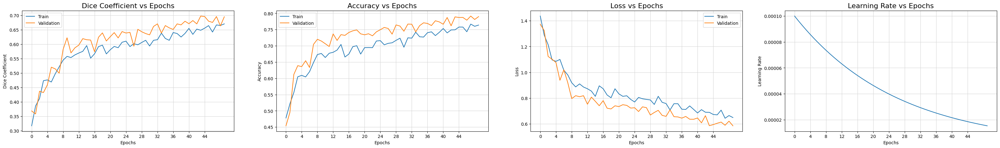

In [27]:
fig, ax = plt.subplots(1, 4, figsize=(40, 5))
ax = ax.ravel()
metrics = ['Dice Coefficient', 'Accuracy', 'Loss', 'Learning Rate']

for i, met in enumerate(['dice_coef', 'accuracy', 'loss', 'lr']):
# metrics = ['Dice Coefficient', 'Accuracy', 'Loss', 'Learning Rate', 'Precision', 'Recall', 'F1 Score']

# for i, met in enumerate(['dice_coef', 'accuracy', 'loss', 'lr', 'recall', 'precision', 'f1']):
    if met != 'lr':
        ax[i].plot(history.history[met])
        ax[i].plot(history.history['val_' + met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,46,4))
        ax[i].legend(['Train', 'Validation'])
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
    else:
        ax[i].plot(history.history[met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,46,4))
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")

plt.savefig('model_metrics_plot.png', facecolor= 'w',transparent= False, bbox_inches= 'tight', dpi= 150)

## Predictions

In [28]:
model.load_weights("simple_VGG19.h5")

In [29]:
testing_gen = ValAugmentGenerator(val_images_dir = val_images, val_masks_dir = val_masks, target_size = (512, 512))

Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.
1/1 [==============================] - 0s 45ms/step


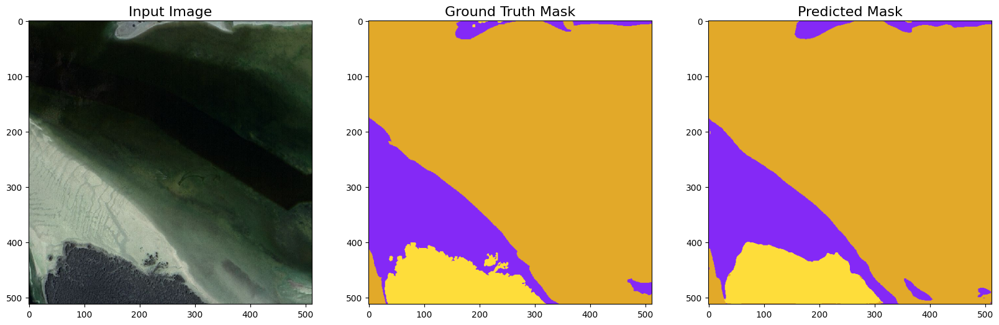

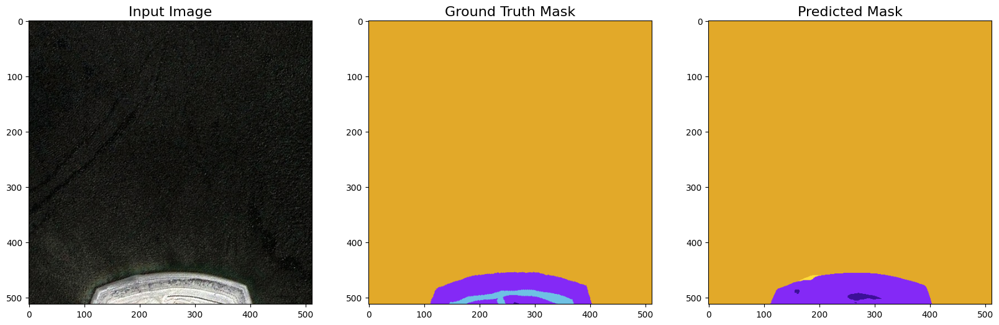

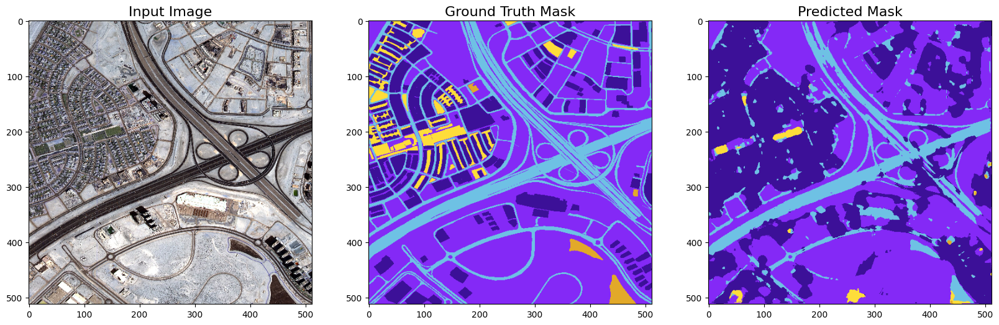

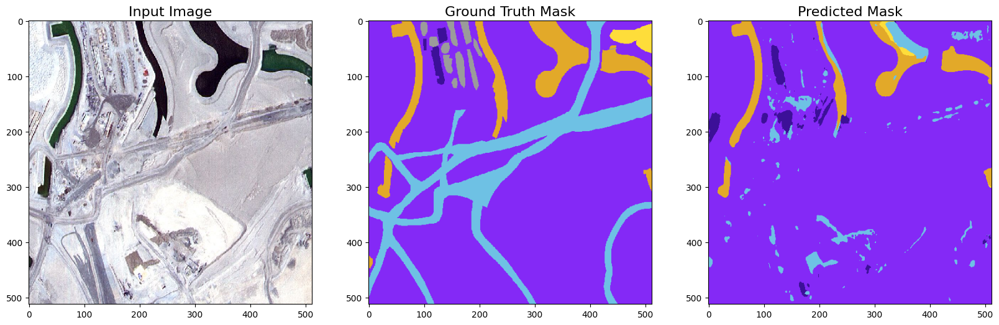

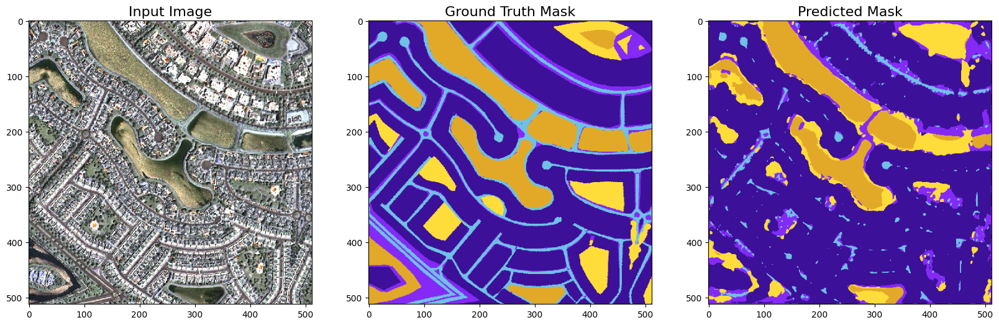

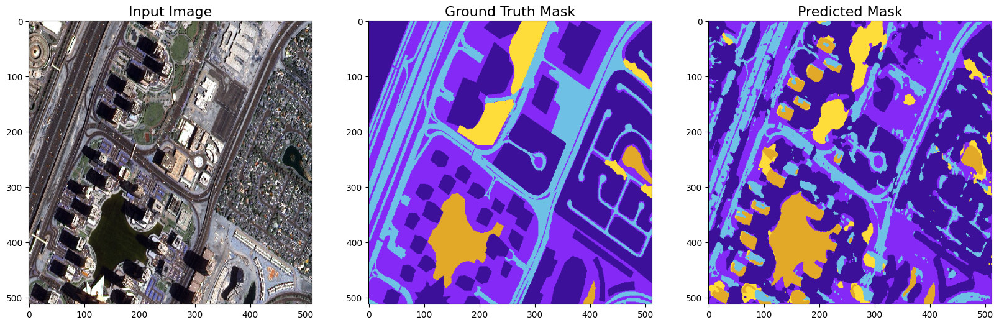

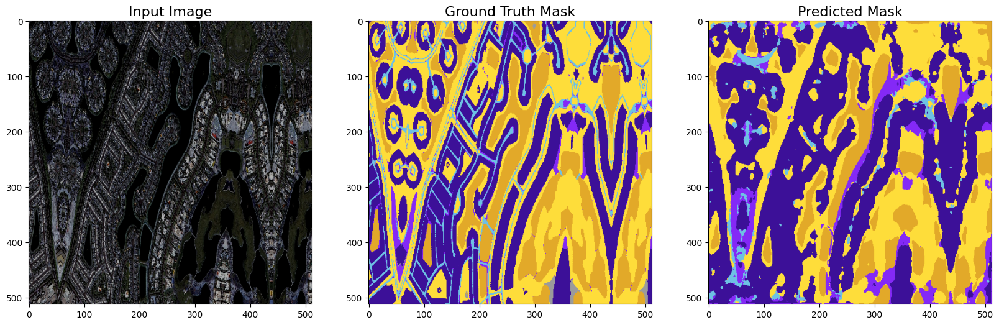

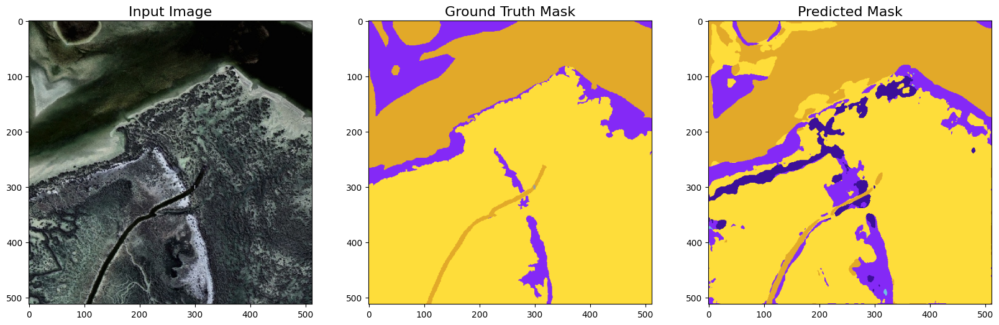

1/1 [==============================] - 0s 93ms/step


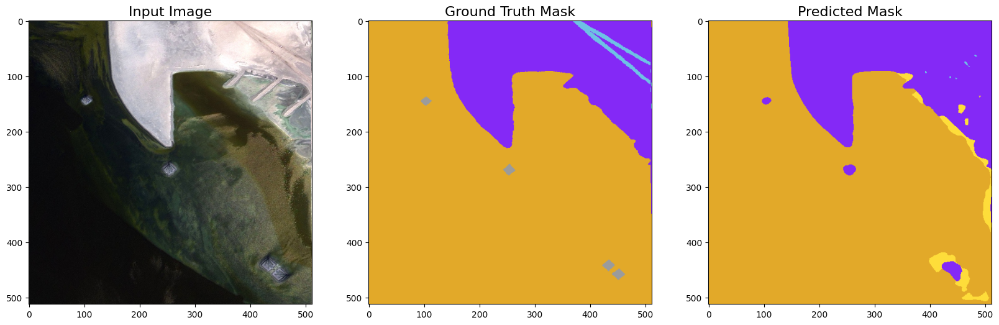

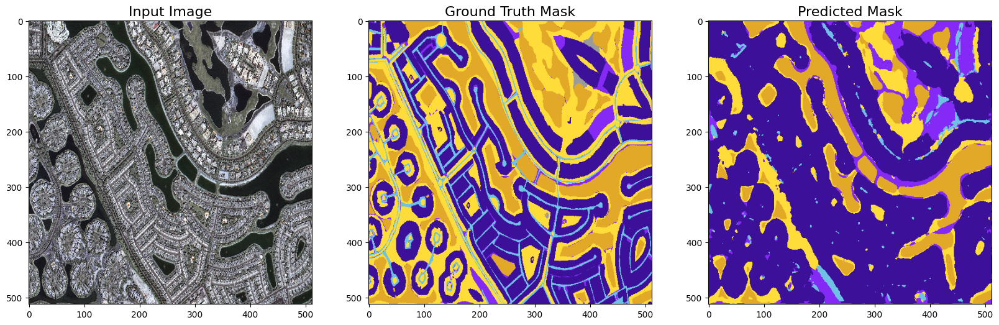

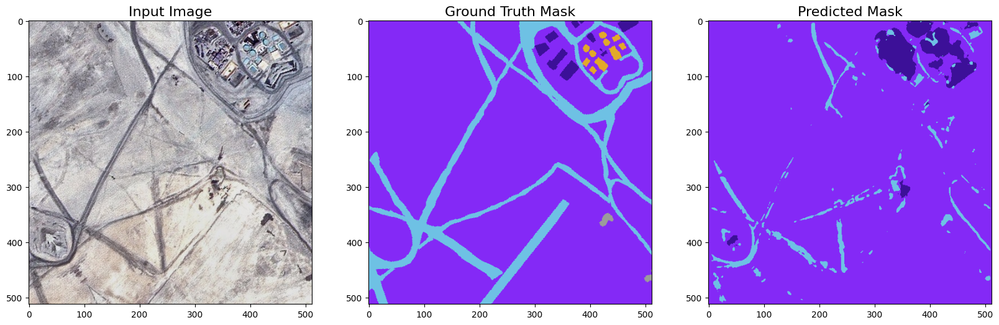

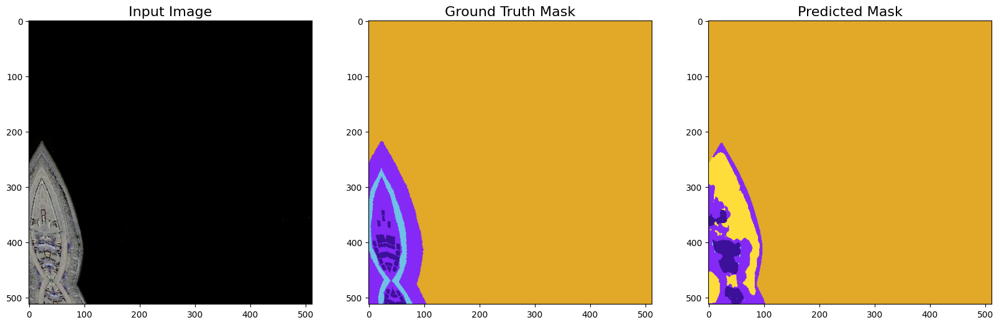

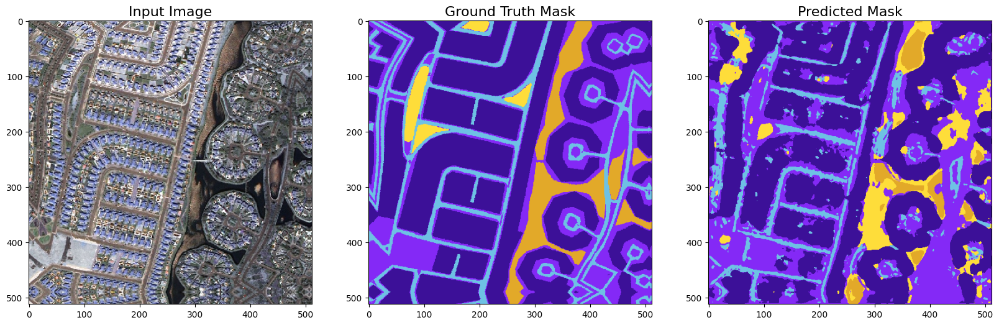

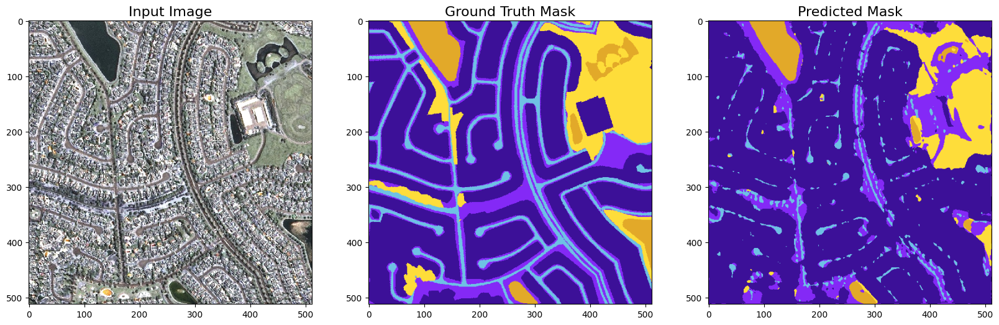

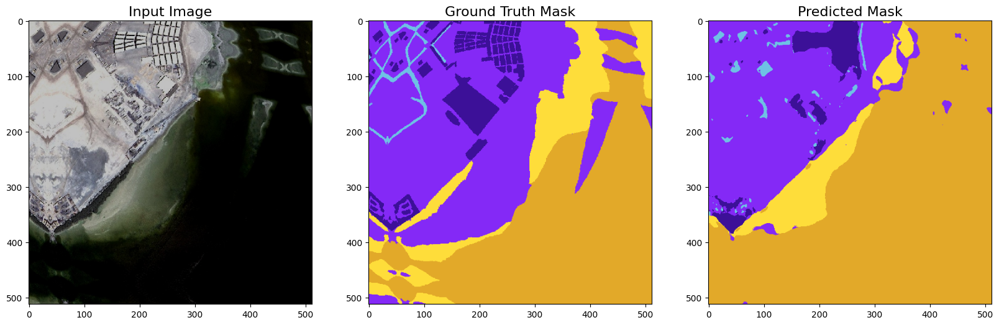

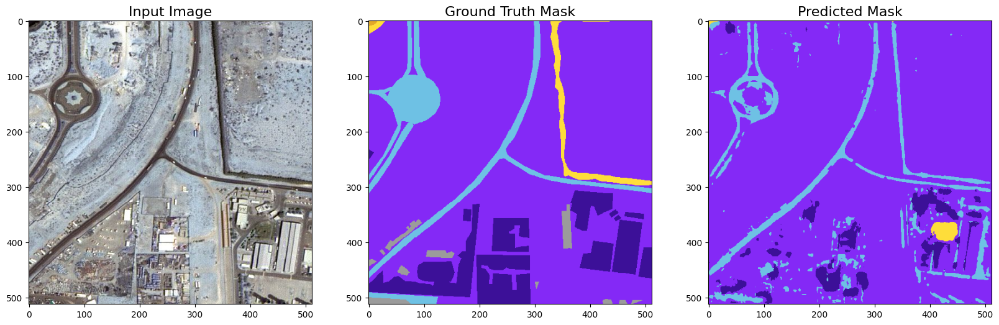

In [30]:
count = 0
for i in range(2):
    batch_img,batch_mask = next(testing_gen)
    pred_all= model.predict(batch_img)
    np.shape(pred_all)

    for j in range(0,np.shape(pred_all)[0]):
        count += 1
        fig = plt.figure(figsize=(20,8))

        ax1 = fig.add_subplot(1,3,1)
        ax1.imshow(batch_img[j])
        ax1.set_title('Input Image', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax1.grid(False)

        ax2 = fig.add_subplot(1,3,2)
        ax2.set_title('Ground Truth Mask', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax2.imshow(onehot_to_rgb(batch_mask[j],id2code))
        ax2.grid(False)

        ax3 = fig.add_subplot(1,3,3)
        ax3.set_title('Predicted Mask', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax3.imshow(onehot_to_rgb(pred_all[j],id2code))
        ax3.grid(False)

        plt.savefig('./prediction_{}.png'.format(count), facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 200)
        plt.show()

In [32]:
from sklearn.metrics import precision_score, recall_score, f1_score

def evaluate_metrics(y_true, y_pred):
    # Flatten the masks
    y_true_flat = y_true.argmax(axis=-1).flatten()
    y_pred_flat = y_pred.argmax(axis=-1).flatten()

    # Compute precision, recall, and F1-score
    precision = precision_score(y_true_flat, y_pred_flat, average='macro')
    recall = recall_score(y_true_flat, y_pred_flat, average='macro')
    f1 = f1_score(y_true_flat, y_pred_flat, average='macro')

    return precision, recall, f1

# Assuming pred_all contains the predicted masks and batch_mask contains the ground truth masks
# Assuming pred_all and batch_mask are in one-hot encoded format
precision, recall, f1 = evaluate_metrics(batch_mask, pred_all)
print("Precision: {:.2f}".format(precision))
print("Recall: {:.2f}".format(recall))
print("F1-score: {:.2f}".format(f1))


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision: 0.55
Recall: 0.52
F1-score: 0.53


## Model's Activations (Outputs) Visualization

In [33]:
# image = load_img('../input/augmented-dubai-aerial-imagery-dataset/val_images/val/image_t4_008.jpg', target_size= (512, 512))
image = load_img('/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/test_images/image_t7_005.jpg', target_size= (512, 512))
image = img_to_array(image)
image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
image = preprocess_input(image)
y_hat = model.predict(image)

1/1 [==============================] - 5s 5s/step


In [34]:
layers=['conv2d', 'conv2d_4', 'conv2d_8', 'conv2d_10', 'conv2d_22', 'conv2d_28', 'conv2d_34', 'conv2d_40', 'conv2d_52', 'conv2d_61', 'conv2d_67', 'conv2d_70']

conv2d (1, 512, 512, 64) 


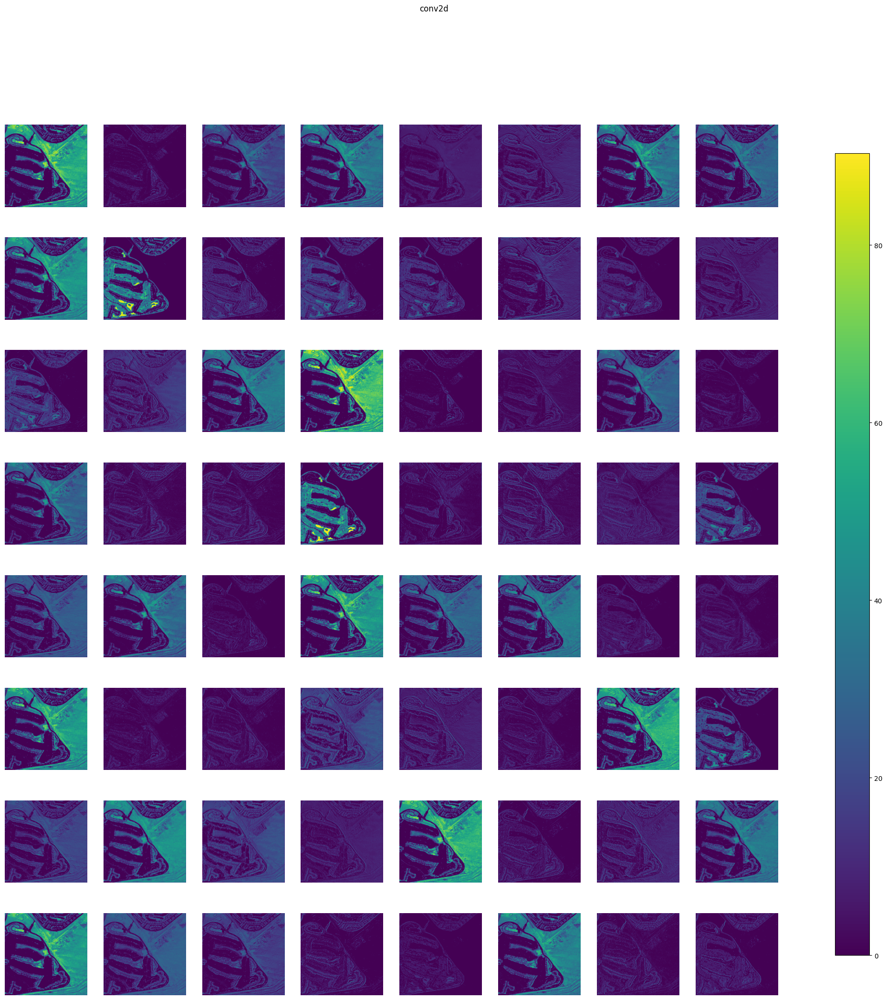

conv2d_4 (1, 128, 128, 256) 


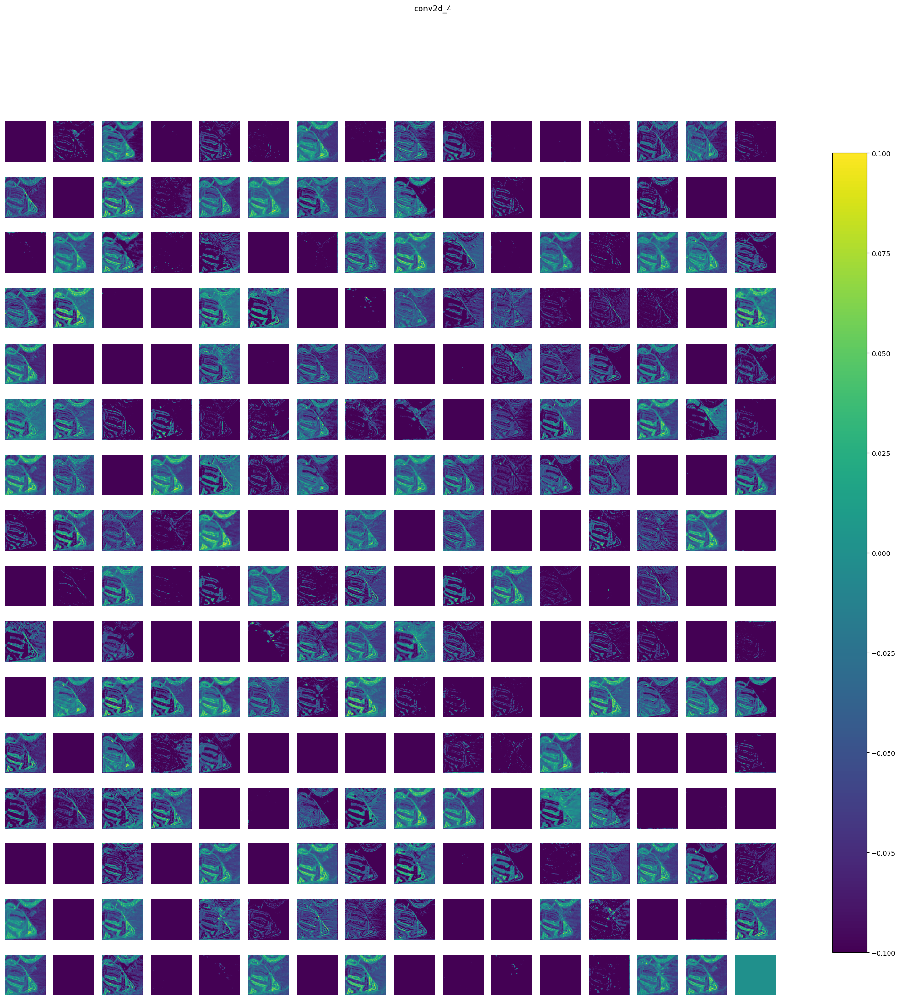

conv2d_8 (1, 64, 64, 512) 


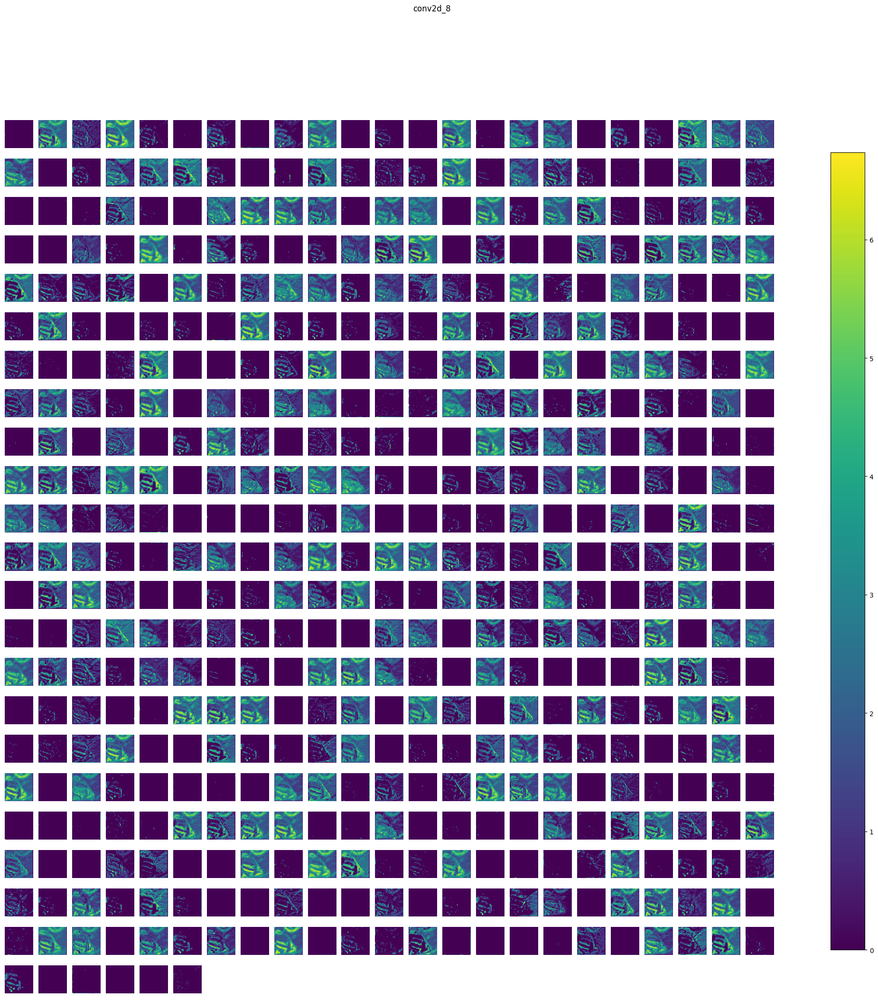

conv2d_10 (1, 64, 64, 512) 


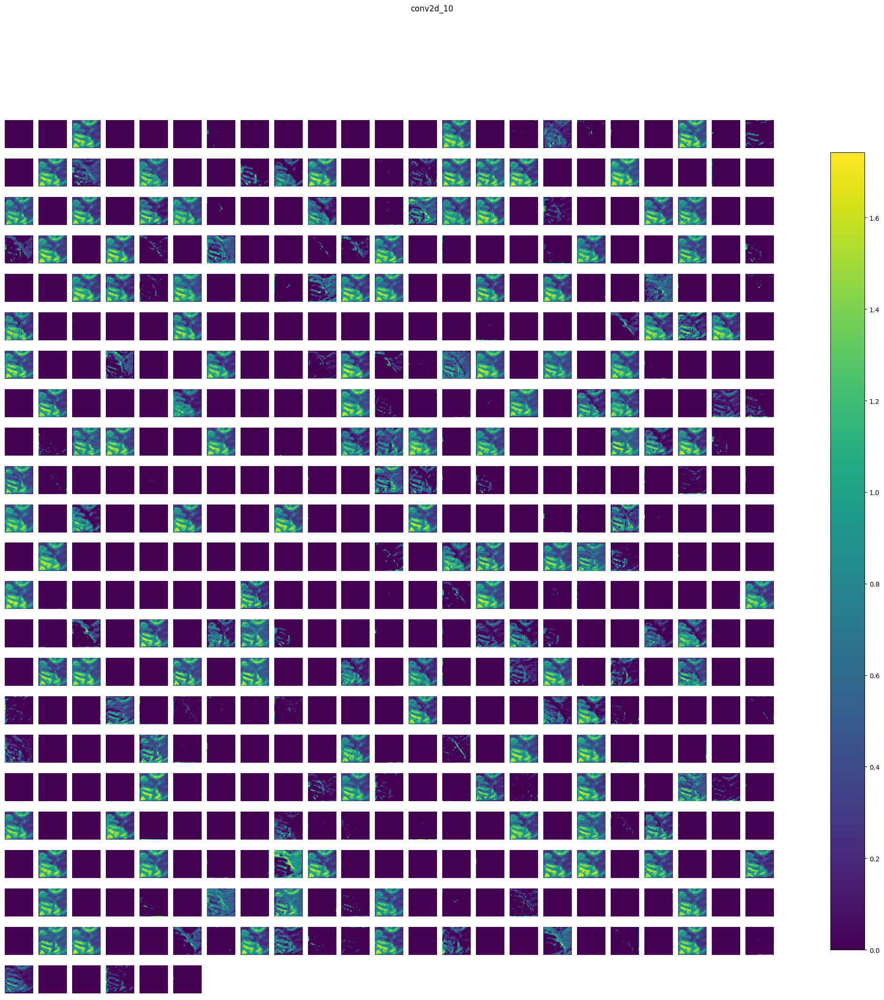

conv2d_22 (1, 64, 64, 512) 


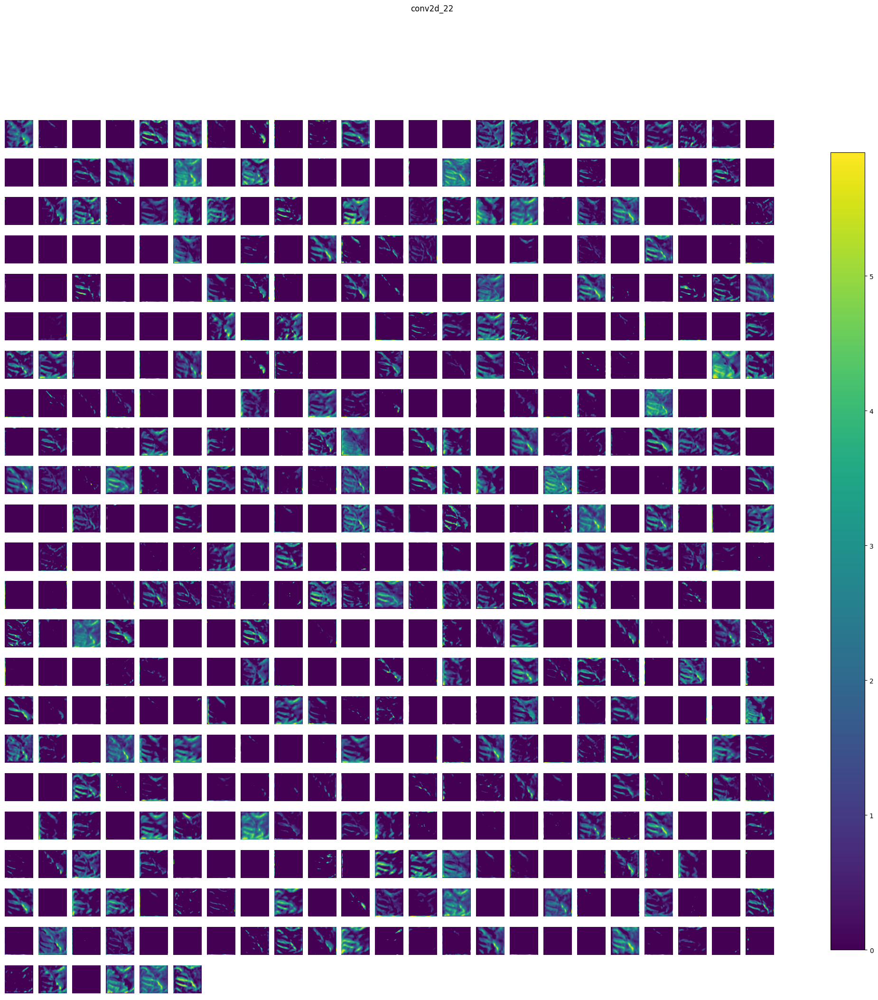

conv2d_28 (1, 256, 256, 128) 


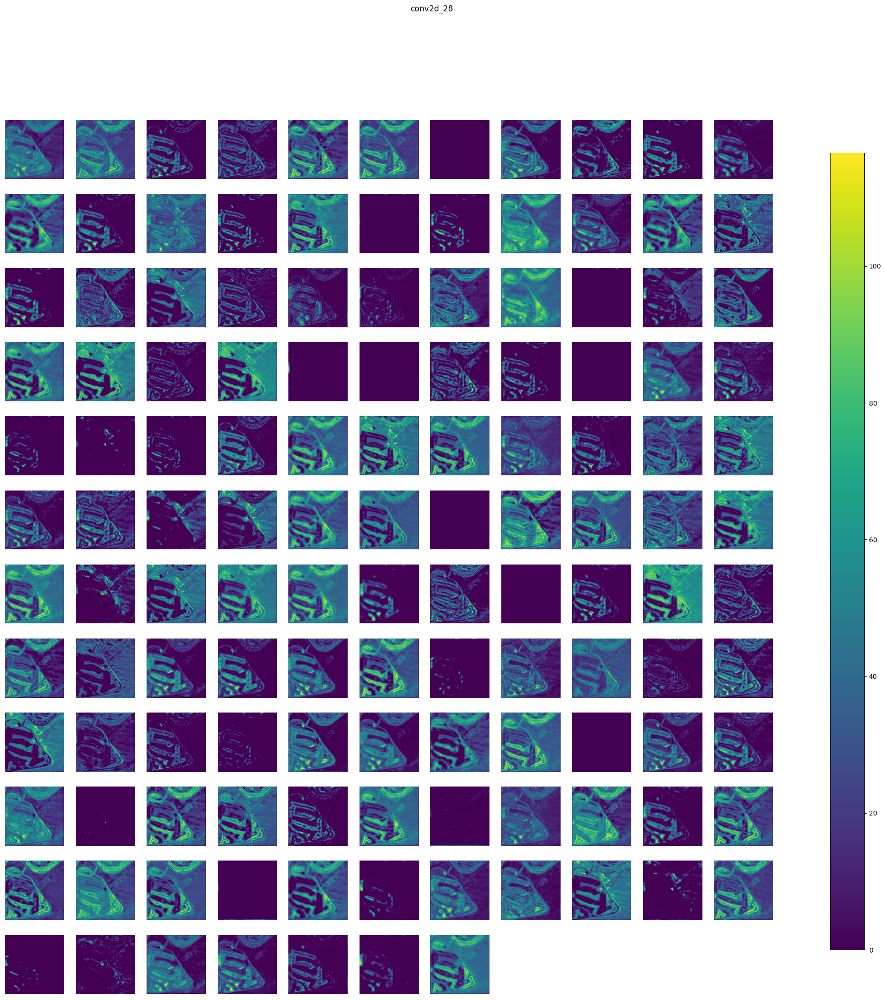

In [35]:
activations= keract.get_activations(model, image, layer_names= layers, nodes_to_evaluate= None, output_format= 'simple', auto_compile= True)
keract.display_activations(activations, cmap='viridis', save= False, directory= './activations')